# Fazendo Download das Imagens

In [ ]:
from bing_image_downloader.downloader import download

#query_string = 'person with hat'
#query_string = 'person'
query_string = 'person with glasses'
print("starting download")
download(query_string, limit=100,  output_dir='downloads', adult_filter_off=True, force_replace=False, timeout=60, verbose=True)


# Excluindo Imagens Corrompidas

In [ ]:
import cv2
import os

def exclude_files(path_to_exclude):
    paths_to_exclude= os.listdir(path_to_exclude)
    for path in paths_to_exclude:
        for file in os.listdir(os.path.join(path_to_exclude,path)):      
            img = cv2.imread(os.path.join(path_to_exclude,path,file))
            if img is None:
                print("\t Exclude file: {}".format(file))
                os.system("del {}".format((os.path.join(path_to_exclude,path,file))))

exclude_files('downloads')

# Carregando as Imagens

In [1]:
from fastai.vision.all import *
import numpy as np

# Know if the GPU is working
import torch
torch.cuda.is_available()

False

In [2]:
np.random.seed(53)
dls = ImageDataLoaders.from_folder('downloads', train='.', valid_pct=0.2, seed=42, item_tfms=Resize(224))

c:\Users\hugog\GitHub\SENAI_minicurso\env\lib\site-packages\PIL\Image.py:992: UserWarning: Palette images with Transparency expressed in bytes should be converted to RGBA images
  warnings.warn(


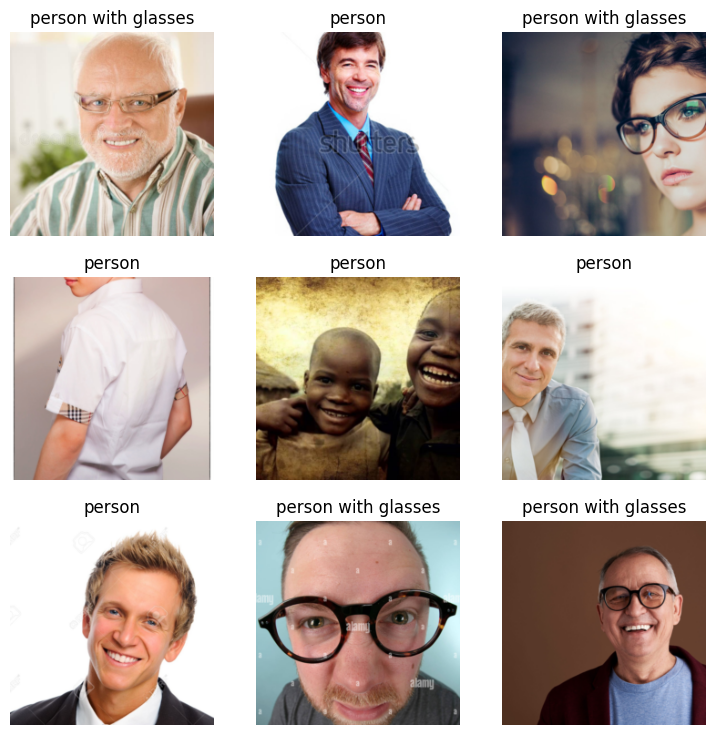

In [3]:
dls.show_batch()

In [4]:
len(dls.train_ds),len(dls.valid_ds)

(141, 35)

# Instanciando e Treinando o Modelo

In [5]:
learn = vision_learner(dls, models.resnet34)#, metrics=error_rate)

c:\Users\hugog\GitHub\SENAI_minicurso\env\lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\hugog\GitHub\SENAI_minicurso\env\lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet34_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet34_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


In [6]:
#learn.fit_one_cycle(10)
#learn.save('stage1')

In [7]:
learn.load('stage1')

In [ ]:
#learn.lr_find()
#learn.recorder.plot_loss()

# Métricas de Validação

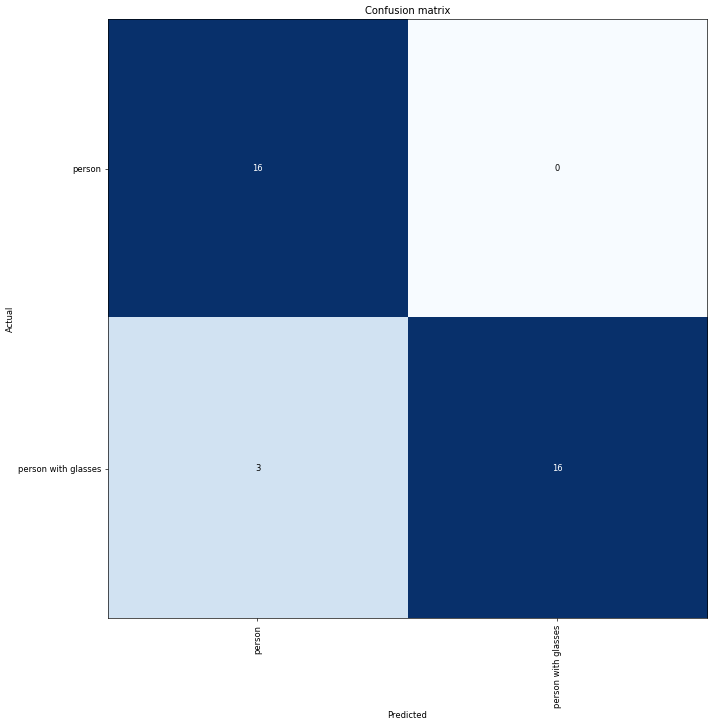

In [8]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(figsize=(12,12), dpi=60)


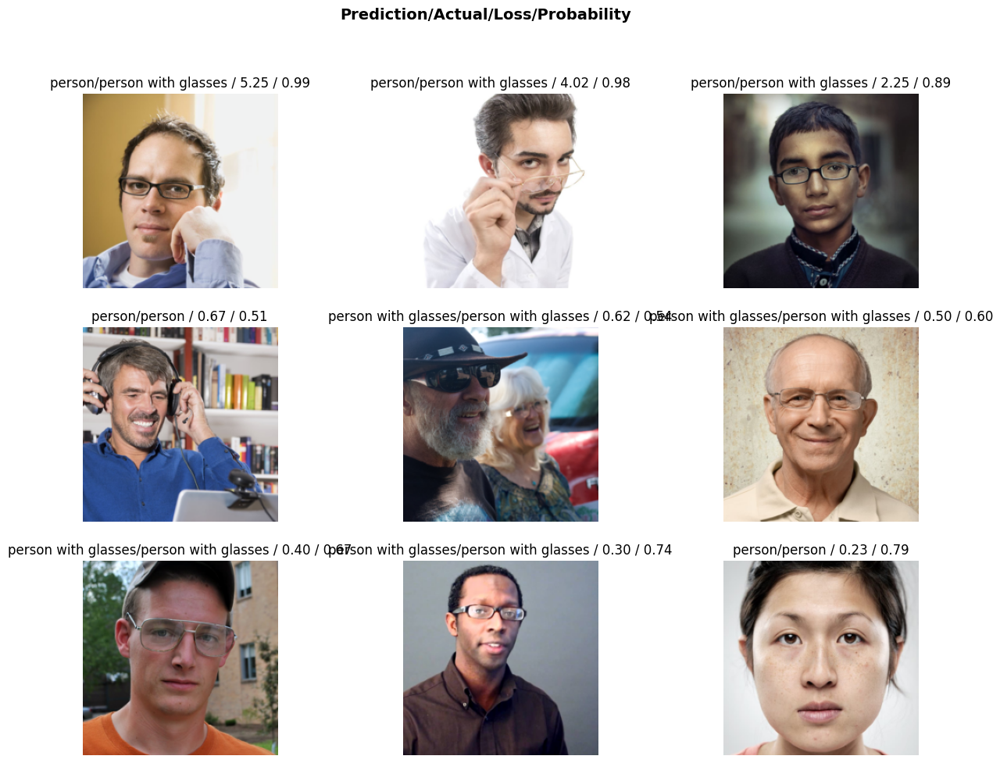

In [9]:
interp.plot_top_losses(9, figsize=(15,11)) #,heatmat=True

# Realizando predições com o modelo treinado

In [18]:
from torchvision import transforms
from PIL import Image

CLASSE DE TESTE: person
IMAGE DE TESTE : Image_38.jpg


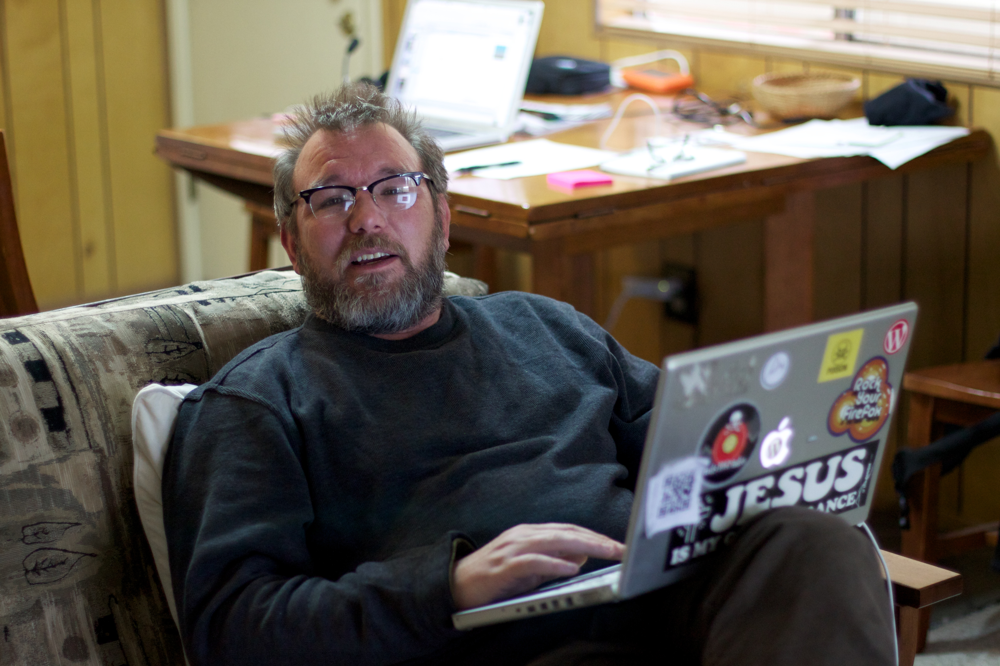

In [19]:
## Open Image
test_class = random.choice(dls.vocab)
print(f"CLASSE DE TESTE: {test_class}")
test_image = random.choice(os.listdir(os.path.join('downloads',test_class)))
print(f"IMAGE DE TESTE : {test_image}")

image_path = os.path.join('downloads',test_class,test_image)
image = Image.open(image_path).convert('RGB')
image


Probabilities: 
	person: 99.99 %
	person with glasses: 0.01 %

Prediction: PERSON


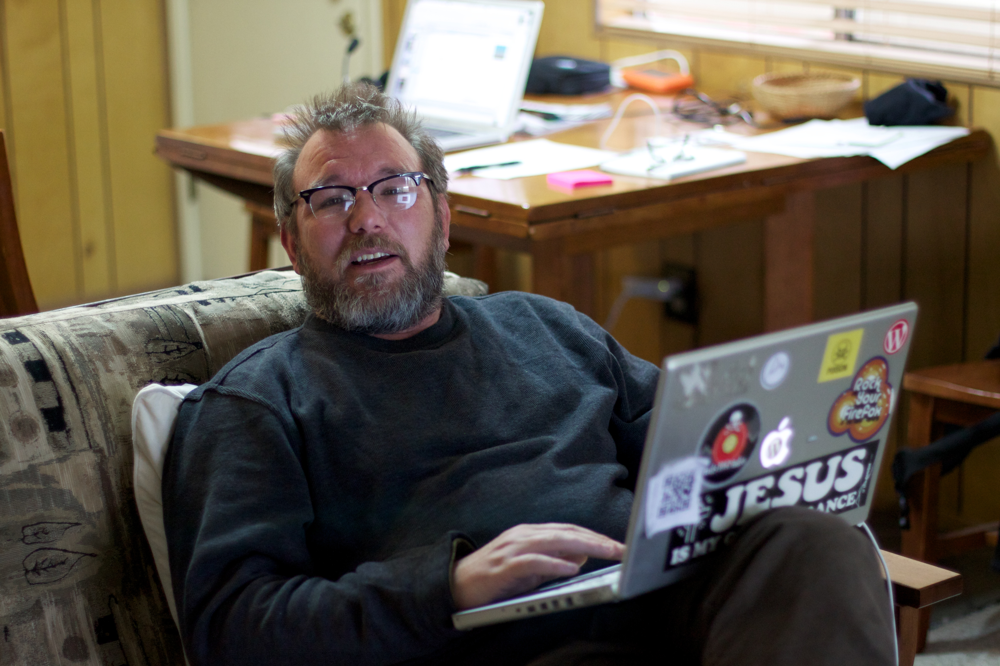

In [20]:
# predict image with learn
pred,pred_idx,probs = learn.predict(image)
print("Probabilities: ")
for i in range(len(dls.vocab)):
    print(f"\t{dls.vocab[i]}: {probs[i].item()*100:.02f} %")

print(f"\nPrediction: {pred.upper()}")
image


# GRAD-CAM

In [21]:
class Hook():
    def __init__(self, m):
        self.hook = m.register_forward_hook(self.hook_func)   
    def hook_func(self, m, i, o): self.stored = o.detach().clone()
    def __enter__(self, *args): return self
    def __exit__(self, *args): self.hook.remove()
class HookBwd():
    def __init__(self, m):
        self.hook = m.register_backward_hook(self.hook_func)   
    def hook_func(self, m, gi, go): self.stored = go[0].detach().clone()
    def __enter__(self, *args): return self
    def __exit__(self, *args): self.hook.remove()

In [22]:
x = first(dls.test_dl([image]))[0]
cls = list(dls.vocab).index(test_class)
with HookBwd(learn.model[0]) as hookg:
    with Hook(learn.model[0]) as hook:
        output = learn.model.eval()(x)
        act = hook.stored
    output[0,cls].backward()
    grad = hookg.stored

In [23]:
w = grad[0].mean(dim=[1,2], keepdim=True)
cam_map = (w * act[0]).sum(0)
cam_map.shape

torch.Size([7, 7])

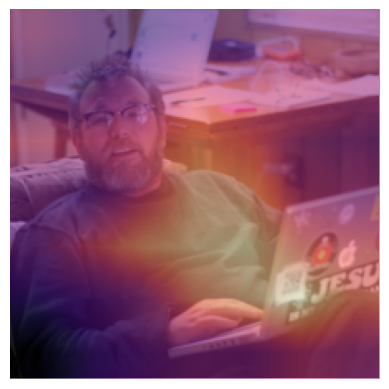

In [24]:
x_dec = TensorImage(dls.train.decode((x,))[0][0])
_,ax = plt.subplots()
x_dec.show(ctx=ax)
ax.imshow(cam_map.detach().cpu(), alpha=0.6, extent=(0,224,224,0),
              interpolation='bilinear', cmap='magma');